In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import matplotlib.pyplot as plt
import os
import anndata
import harmonypy as hm
import seaborn as sns
import scrublet as scr
import bbknn as bk
%matplotlib inline

/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
sc.settings.set_figure_params(dpi=250,fontsize=10)

In [4]:
adata = sc.read_h5ad("/rds/general/user/snb20/home/2_Organotypic_EC_Heterogeneity/Sanger_Datasets/Resolve/Test/Test2_nolog/bin50_D2-1.h5ad")

In [5]:
adata

AnnData object with n_obs × n_vars = 105486 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

In [6]:
adata.obs['arterial_ec'] = (adata.X[:,adata.var_names=='GJA5'] > 1) & (adata.X[:,adata.var_names=='VWF'] > 1)

In [7]:
adata_aec = adata[adata.obs['arterial_ec'] == True]

In [8]:
adata_aec

View of AnnData object with n_obs × n_vars = 790 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_ec'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

In [9]:
data = adata_aec.obs[['X_coor','Y_coor']]
linkage_data = linkage(data, method='average', metric='euclidean')

In [10]:
temp = dendrogram(linkage_data,no_plot=True)

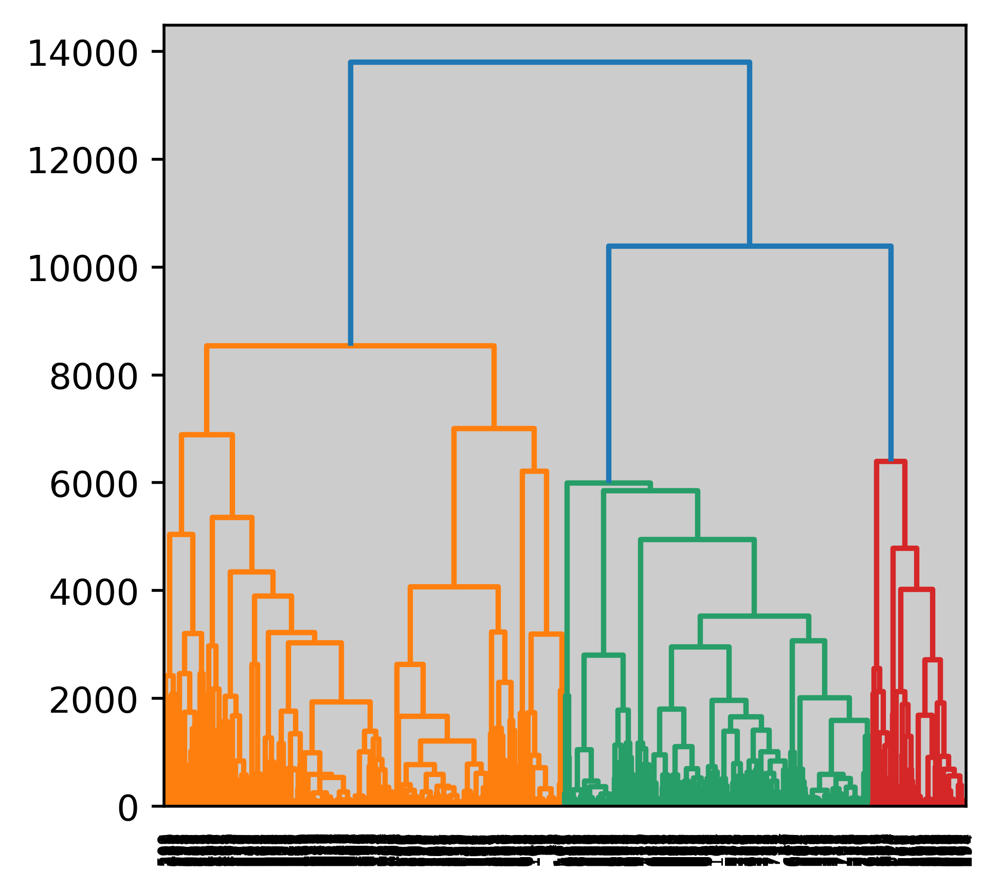

In [11]:
dendrogram(linkage_data)
plt.show()

In [12]:
# adjust n_clusters to relevant number of vessels
hierarchical_cluster = AgglomerativeClustering(n_clusters=227, affinity='euclidean', linkage='single')

In [13]:
labels = hierarchical_cluster.fit_predict(data) 
print(labels)

[218 218   3   3   3  26 205  22  22  22  22 218 202   3   3  22  73   3
  22  73  22  22   3  22  22   3  22  22  54  32  54  32 152   5   5  82
  82  17  30   5   5  30  30 203  17  33  11  33  33  33   6  33  33  33
  33   4   4   4   4   4  33  33  33  33  33  33  33   4  11  33  33  33
  33  33   4   4  33  33  33  33  33   6   6   6   6   6   6   8   6   6
 164   6 146   8 189 189   8 189 189  48  31  31  48 162   8 223 191 135
 180  10 122 119 125  10  96  96  96  96  96  96  77  77  77  77  77 159
   0   0   0 113   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0  40   0   0  40  21   0  21 224   0 114  21  21   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0 126   0   0   0   0 175   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0 115   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0 208 208   0   0 186 121  92  92 201
 157 157 157 207 194 194 194 116  18  18 109 109  1

/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [14]:
adata_aec.obs['Artery_clusters'] = labels
adata_aec.obs['Artery_clusters'] = adata_aec.obs['Artery_clusters'].astype('category')

/var/tmp/pbs.8217755.pbs/ipykernel_3431134/2590496195.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_aec.obs['Artery_clusters'] = labels
/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/contextlib.py:142: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


In [15]:
adata_aec.obs['Artery_clusters'].value_counts()

0      89
22     55
43     44
19     30
33     25
       ..
129     1
128     1
127     1
126     1
226     1
Name: Artery_clusters, Length: 227, dtype: int64

In [16]:
# subset for clusters > 5 bins
adata_aec.obs['Artery_clusters'].value_counts()[adata_aec.obs['Artery_clusters'].value_counts() > 5].index.tolist()

[0,
 22,
 43,
 19,
 33,
 50,
 27,
 12,
 98,
 3,
 49,
 1,
 103,
 78,
 6,
 210,
 18,
 2,
 4,
 109,
 96,
 13,
 105,
 25,
 39]

In [17]:
adata_aec_subset = adata_aec[adata_aec.obs.Artery_clusters.isin(adata_aec.obs['Artery_clusters'].value_counts()[adata_aec.obs['Artery_clusters'].value_counts() > 5].index.tolist())]

In [18]:
adata_aec_subset.obs.Artery_clusters = adata_aec_subset.obs.Artery_clusters.astype(str).astype('category')

/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/pandas/core/generic.py:5931: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  self[name] = value


In [110]:
## adata_aec

In [111]:
#sc.pl.spatial(adata,color="VWF",img_key='WGA',size=8, alpha_img = 0.2, vmax = 1)

In [112]:
#sc.pl.spatial(adata,color="GJA5",img_key='WGA',size=8, alpha_img = 0.2, vmax = 1)

In [113]:
#del adata_aec.uns['Artery_clusters_colors']
#del adata_aec_subset.uns['Artery_clusters_colors']

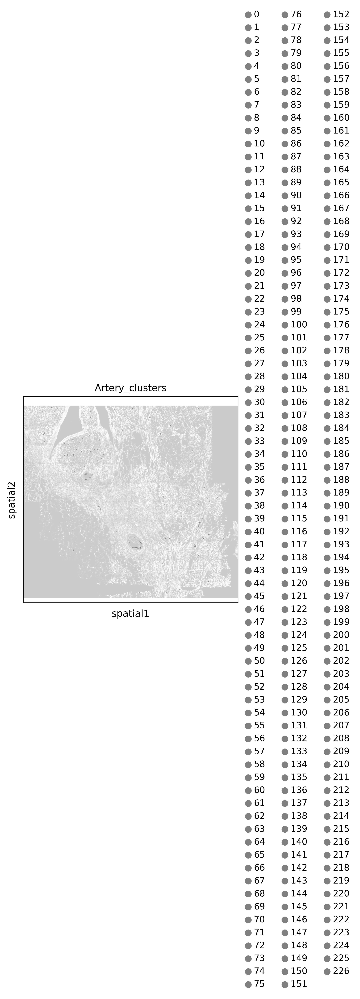

In [114]:
sc.pl.spatial(adata_aec, color="Artery_clusters",img_key='WGA',size=8, alpha_img = 0.2)

In [115]:
#del adata_aec_subset.uns['Artery_clusters_colors']

In [116]:
adata_aec_subset

AnnData object with n_obs × n_vars = 448 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_ec', 'Artery_clusters'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

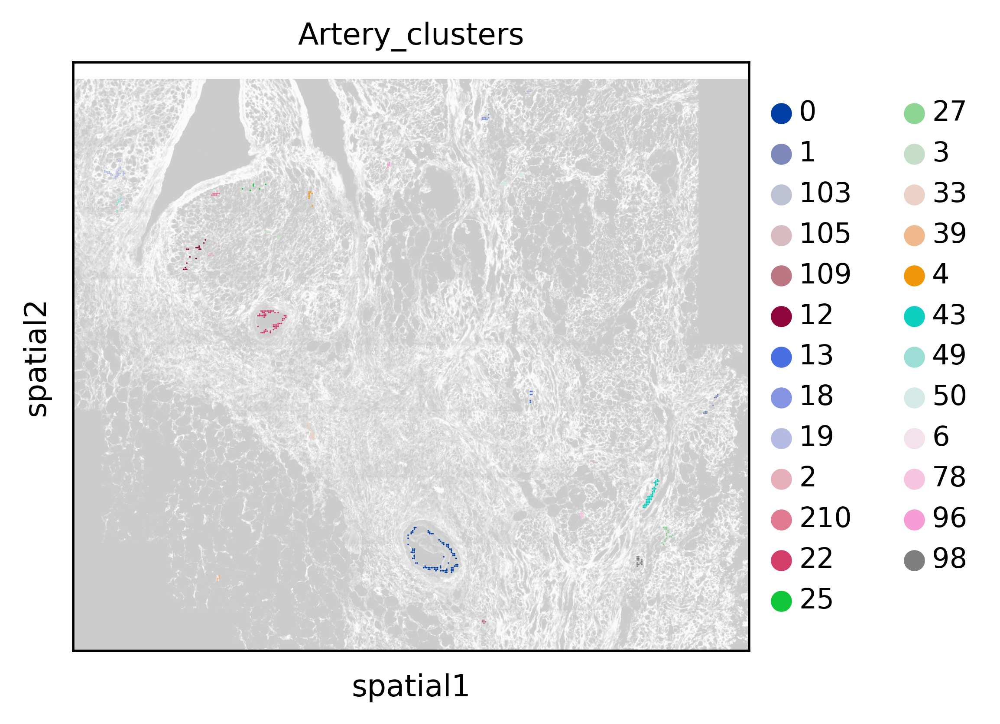

In [117]:
sc.pl.spatial(adata_aec_subset,
              color="Artery_clusters",img_key='WGA',size=10, alpha_img = 0.2)

/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/rds/general/user/snb20/home/anaconda3/envs/scanpy1.8.2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


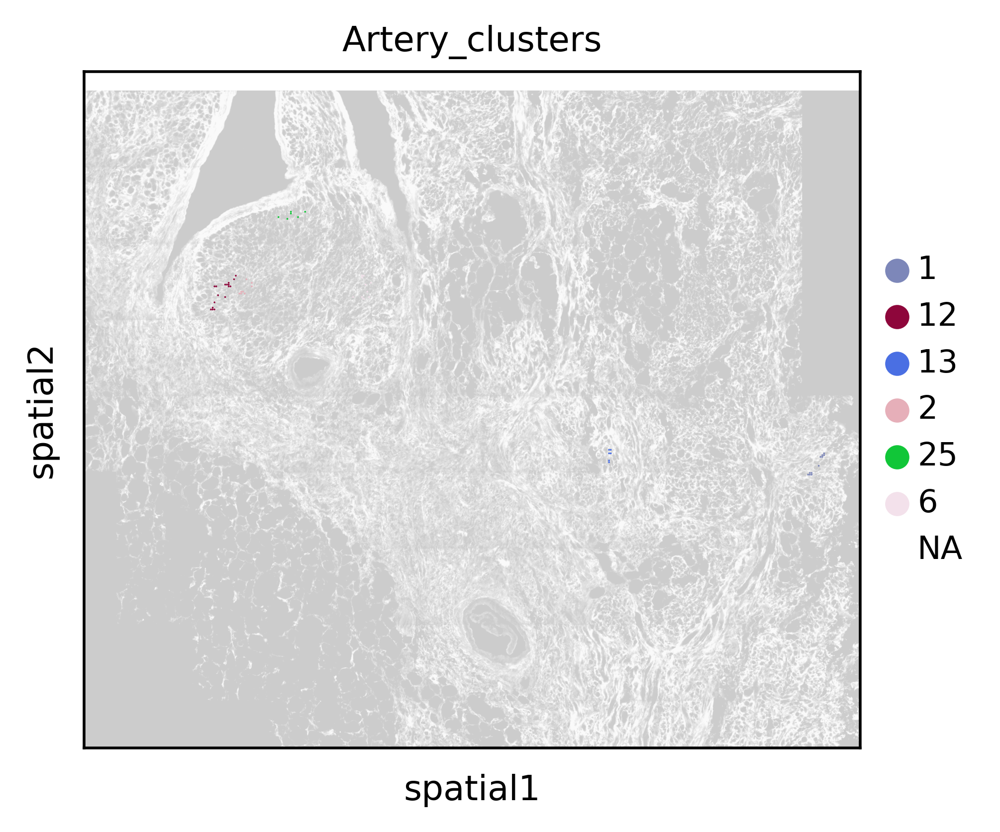

In [124]:
sc.pl.spatial(adata_aec_subset,
              color="Artery_clusters", groups = ["6","1","12","25","2","13"] ,img_key='WGA',size=10, alpha_img = 0.2)

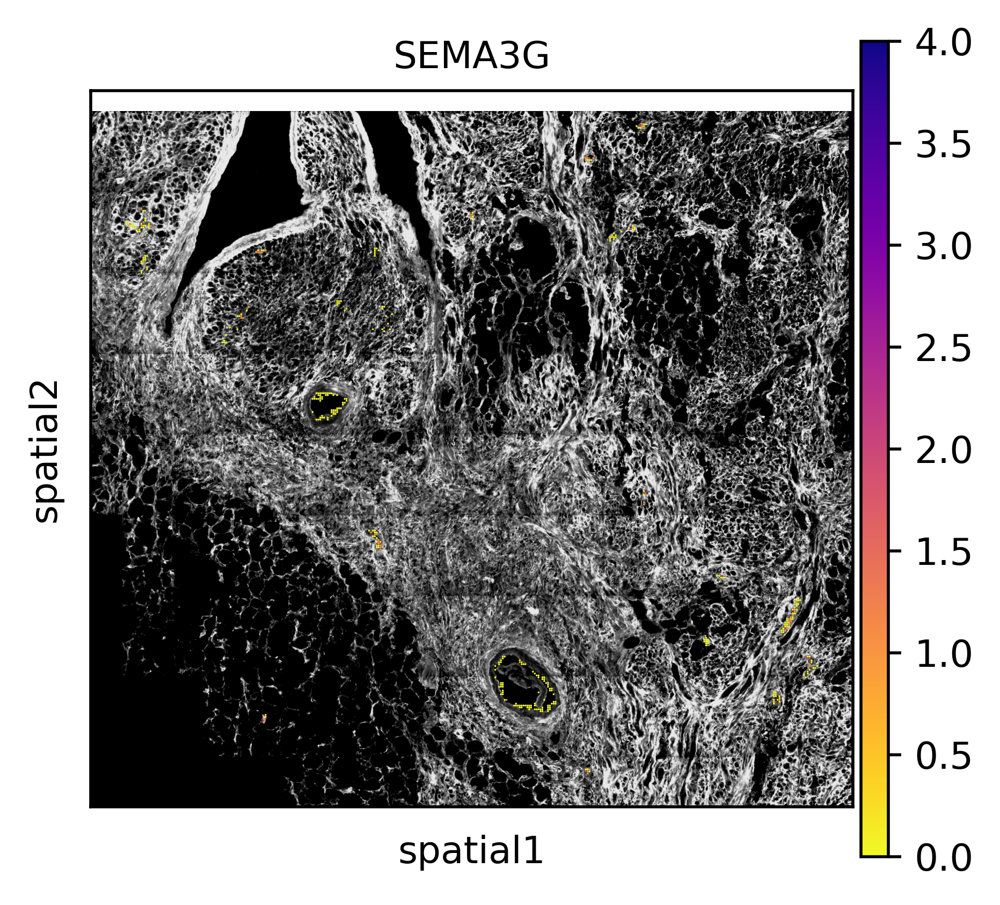

In [66]:
sc.pl.spatial(adata_aec_subset,
              color="SEMA3G",img_key='WGA',size=10, alpha_img = 1, cmap = 'plasma_r')

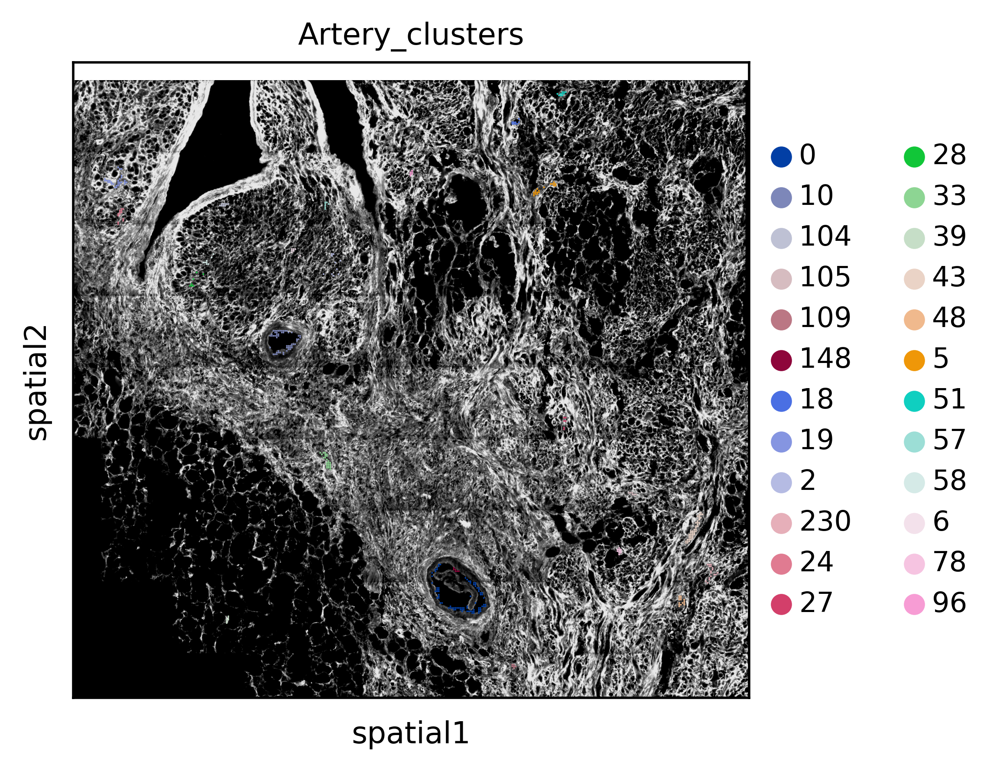

In [64]:
sc.pl.spatial(adata_aec_subset,
              color="Artery_clusters",img_key='WGA',size=10, alpha_img = 1)

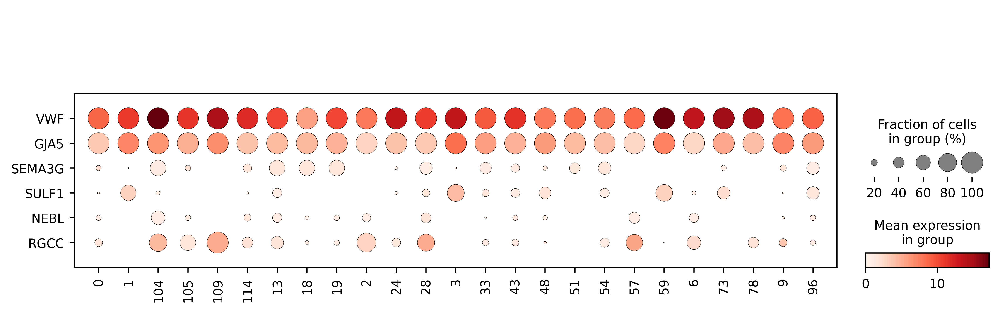

In [35]:
markers = ["VWF","GJA5","SEMA3G","SULF1","NEBL","RGCC"]
sc.pl.dotplot(adata_aec_subset, markers, "Artery_clusters", mean_only_expressed = True, swap_axes = True)
#sc.pl.dotplot(adata_aec_subset, markers, "Artery_clusters", mean_only_expressed = False)

In [ ]:
sc.pl.spatial(adata_aec_subset,
              color="Artery_clusters",img_key='WGA',size=6)

### obtain bins percent expressing values

In [19]:
adata_aec_subset.obs['SULF1_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='SULF1'] > 1)

In [20]:
adata_aec_subset.obs['NEBL_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='NEBL'] > 1)

In [21]:
adata_aec_subset.obs['SEMA3G_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='SEMA3G'] > 0)

In [22]:
adata_aec_subset.obs['RGCC_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='RGCC'] > 0)

In [23]:
adata_aec_subset.obs['SULF1+NEBL_percent'] = (adata_aec_subset.X[:,adata_aec_subset.var_names=='SULF1'] > 1) & (adata_aec_subset.X[:,adata_aec_subset.var_names=='NEBL'] > 1)

In [24]:
adata_aec_subset

AnnData object with n_obs × n_vars = 448 × 99
    obs: 'X_Y_bins', 'X_coor', 'Y_coor', 'arterial_ec', 'Artery_clusters', 'SULF1_percent', 'NEBL_percent', 'SEMA3G_percent', 'RGCC_percent', 'SULF1+NEBL_percent'
    var: 'Genes'
    uns: 'spatial'
    obsm: 'spatial'

In [25]:
results = adata_aec_subset.obs[['SULF1+NEBL_percent','SULF1_percent','NEBL_percent','SEMA3G_percent','RGCC_percent','Artery_clusters']].groupby('Artery_clusters').mean()

In [26]:
results

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent
Artery_clusters,,,,,
0,0.0,0.561798,0.000000,0.022472,0.011236
1,0.0,0.000000,0.000000,0.000000,0.454545
103,0.0,0.000000,0.000000,0.400000,0.000000
105,0.0,0.000000,0.000000,0.166667,0.666667
109,0.0,0.000000,0.000000,0.500000,0.333333
12,0.0,0.058824,0.176471,0.235294,0.823529
13,0.0,0.000000,0.000000,0.666667,0.500000
18,0.0,0.000000,0.000000,0.666667,0.111111
19,0.0,0.000000,0.033333,0.200000,0.266667


### obtain mean expression (all bins / cluster)

In [27]:
matrix=pd.DataFrame(adata_aec_subset.X,columns=adata_aec_subset.raw.var.index,index=adata_aec_subset.obs.index)

In [28]:
matrix["Artery_clusters"] = adata_aec_subset.obs["Artery_clusters"]

In [29]:
df_mean=matrix.groupby("Artery_clusters").mean()

In [30]:
df_mean[["SULF1","NEBL","SEMA3G","RGCC"]]

Genes,SULF1,NEBL,SEMA3G,RGCC
Artery_clusters,,,,
0,2.325843,0.000000,0.022472,0.011236
1,0.090909,0.000000,0.000000,0.727273
103,0.000000,0.000000,0.500000,0.000000
105,0.000000,0.166667,0.333333,1.000000
109,0.333333,0.000000,0.666667,0.333333
12,0.176471,0.588235,0.235294,3.529412
13,0.333333,0.333333,1.000000,0.833333
18,0.000000,0.111111,0.888889,0.111111
19,0.033333,0.100000,0.300000,1.000000


### obtain mean expression (expressing bins only / cluster)

In [31]:
matrix2 = matrix.replace(0, np.NaN)

In [32]:
df_mean_nonzero =matrix2.groupby("Artery_clusters").mean()

In [33]:
df_mean_nonzero[["SULF1","NEBL","SEMA3G","RGCC"]]

Genes,SULF1,NEBL,SEMA3G,RGCC
Artery_clusters,,,,
0,3.285714,NaN,1.000000,1.000000
1,1.000000,NaN,NaN,1.600000
103,NaN,NaN,1.250000,NaN
105,NaN,1.000000,2.000000,1.500000
109,1.000000,NaN,1.333333,1.000000
12,1.500000,1.666667,1.000000,4.285714
13,1.000000,1.000000,1.500000,1.666667
18,NaN,1.000000,1.333333,1.000000
19,1.000000,1.500000,1.500000,3.750000


### add expression values to dataframe

In [34]:
#mean expression (all bins / cluster)
test = pd.concat([results, df_mean[["SULF1","NEBL","SEMA3G","RGCC"]]], axis = 1)

In [35]:
test

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1,NEBL,SEMA3G,RGCC
Artery_clusters,,,,,,,,,
0,0.0,0.561798,0.000000,0.022472,0.011236,2.325843,0.000000,0.022472,0.011236
1,0.0,0.000000,0.000000,0.000000,0.454545,0.090909,0.000000,0.000000,0.727273
103,0.0,0.000000,0.000000,0.400000,0.000000,0.000000,0.000000,0.500000,0.000000
105,0.0,0.000000,0.000000,0.166667,0.666667,0.000000,0.166667,0.333333,1.000000
109,0.0,0.000000,0.000000,0.500000,0.333333,0.333333,0.000000,0.666667,0.333333
12,0.0,0.058824,0.176471,0.235294,0.823529,0.176471,0.588235,0.235294,3.529412
13,0.0,0.000000,0.000000,0.666667,0.500000,0.333333,0.333333,1.000000,0.833333
18,0.0,0.000000,0.000000,0.666667,0.111111,0.000000,0.111111,0.888889,0.111111
19,0.0,0.000000,0.033333,0.200000,0.266667,0.033333,0.100000,0.300000,1.000000


In [36]:
#mean expression (expressing bins only / cluster)
test2 = pd.concat([results, df_mean_nonzero[["SULF1","NEBL","SEMA3G","RGCC"]]], axis = 1)

In [37]:
test2

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1,NEBL,SEMA3G,RGCC
Artery_clusters,,,,,,,,,
0,0.0,0.561798,0.000000,0.022472,0.011236,3.285714,NaN,1.000000,1.000000
1,0.0,0.000000,0.000000,0.000000,0.454545,1.000000,NaN,NaN,1.600000
103,0.0,0.000000,0.000000,0.400000,0.000000,NaN,NaN,1.250000,NaN
105,0.0,0.000000,0.000000,0.166667,0.666667,NaN,1.000000,2.000000,1.500000
109,0.0,0.000000,0.000000,0.500000,0.333333,1.000000,NaN,1.333333,1.000000
12,0.0,0.058824,0.176471,0.235294,0.823529,1.500000,1.666667,1.000000,4.285714
13,0.0,0.000000,0.000000,0.666667,0.500000,1.000000,1.000000,1.500000,1.666667
18,0.0,0.000000,0.000000,0.666667,0.111111,NaN,1.000000,1.333333,1.000000
19,0.0,0.000000,0.033333,0.200000,0.266667,1.000000,1.500000,1.500000,3.750000


In [38]:
test2.rename(columns={"SULF1": "SULF1_mean", "NEBL": "NEBL_mean", "SEMA3G": "SEMA3G_mean", "RGCC": "RGCC_mean"}, inplace = True)

In [39]:
test2

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1_mean,NEBL_mean,SEMA3G_mean,RGCC_mean
Artery_clusters,,,,,,,,,
0,0.0,0.561798,0.000000,0.022472,0.011236,3.285714,NaN,1.000000,1.000000
1,0.0,0.000000,0.000000,0.000000,0.454545,1.000000,NaN,NaN,1.600000
103,0.0,0.000000,0.000000,0.400000,0.000000,NaN,NaN,1.250000,NaN
105,0.0,0.000000,0.000000,0.166667,0.666667,NaN,1.000000,2.000000,1.500000
109,0.0,0.000000,0.000000,0.500000,0.333333,1.000000,NaN,1.333333,1.000000
12,0.0,0.058824,0.176471,0.235294,0.823529,1.500000,1.666667,1.000000,4.285714
13,0.0,0.000000,0.000000,0.666667,0.500000,1.000000,1.000000,1.500000,1.666667
18,0.0,0.000000,0.000000,0.666667,0.111111,NaN,1.000000,1.333333,1.000000
19,0.0,0.000000,0.033333,0.200000,0.266667,1.000000,1.500000,1.500000,3.750000


## add raw values

In [40]:
df_sum=matrix.groupby("Artery_clusters").sum()

In [41]:
df_sum[["SULF1","NEBL","SEMA3G","RGCC","GJA5"]]

Genes,SULF1,NEBL,SEMA3G,RGCC,GJA5
Artery_clusters,,,,,
0,207.0,0.0,2.0,1.0,657.0
1,1.0,0.0,0.0,8.0,35.0
103,0.0,0.0,5.0,0.0,43.0
105,0.0,1.0,2.0,6.0,30.0
109,2.0,0.0,4.0,2.0,25.0
12,3.0,10.0,4.0,60.0,55.0
13,2.0,2.0,6.0,5.0,26.0
18,0.0,1.0,8.0,1.0,40.0
19,1.0,3.0,9.0,30.0,217.0


In [42]:
test3 = pd.concat([test2, df_sum[["SULF1","NEBL","SEMA3G","RGCC"]]], axis = 1)

In [43]:
test3

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1_mean,NEBL_mean,SEMA3G_mean,RGCC_mean,SULF1,NEBL,SEMA3G,RGCC
Artery_clusters,,,,,,,,,,,,,
0,0.0,0.561798,0.000000,0.022472,0.011236,3.285714,NaN,1.000000,1.000000,207.0,0.0,2.0,1.0
1,0.0,0.000000,0.000000,0.000000,0.454545,1.000000,NaN,NaN,1.600000,1.0,0.0,0.0,8.0
103,0.0,0.000000,0.000000,0.400000,0.000000,NaN,NaN,1.250000,NaN,0.0,0.0,5.0,0.0
105,0.0,0.000000,0.000000,0.166667,0.666667,NaN,1.000000,2.000000,1.500000,0.0,1.0,2.0,6.0
109,0.0,0.000000,0.000000,0.500000,0.333333,1.000000,NaN,1.333333,1.000000,2.0,0.0,4.0,2.0
12,0.0,0.058824,0.176471,0.235294,0.823529,1.500000,1.666667,1.000000,4.285714,3.0,10.0,4.0,60.0
13,0.0,0.000000,0.000000,0.666667,0.500000,1.000000,1.000000,1.500000,1.666667,2.0,2.0,6.0,5.0
18,0.0,0.000000,0.000000,0.666667,0.111111,NaN,1.000000,1.333333,1.000000,0.0,1.0,8.0,1.0
19,0.0,0.000000,0.033333,0.200000,0.266667,1.000000,1.500000,1.500000,3.750000,1.0,3.0,9.0,30.0


### add cluster size (no. bins / vessel)

In [44]:
results2 = test3.join(adata_aec_subset.obs['Artery_clusters'].value_counts(), on=None, how='left', lsuffix='', rsuffix='', sort=False, validate=None)

In [45]:
results2.columns = list(results2.columns[0:13]) + ['size']

In [46]:
results2

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1_mean,NEBL_mean,SEMA3G_mean,RGCC_mean,SULF1,NEBL,SEMA3G,RGCC,size
Artery_clusters,,,,,,,,,,,,,,
0,0.0,0.561798,0.000000,0.022472,0.011236,3.285714,NaN,1.000000,1.000000,207.0,0.0,2.0,1.0,89
1,0.0,0.000000,0.000000,0.000000,0.454545,1.000000,NaN,NaN,1.600000,1.0,0.0,0.0,8.0,11
103,0.0,0.000000,0.000000,0.400000,0.000000,NaN,NaN,1.250000,NaN,0.0,0.0,5.0,0.0,10
105,0.0,0.000000,0.000000,0.166667,0.666667,NaN,1.000000,2.000000,1.500000,0.0,1.0,2.0,6.0,6
109,0.0,0.000000,0.000000,0.500000,0.333333,1.000000,NaN,1.333333,1.000000,2.0,0.0,4.0,2.0,6
12,0.0,0.058824,0.176471,0.235294,0.823529,1.500000,1.666667,1.000000,4.285714,3.0,10.0,4.0,60.0,17
13,0.0,0.000000,0.000000,0.666667,0.500000,1.000000,1.000000,1.500000,1.666667,2.0,2.0,6.0,5.0,6
18,0.0,0.000000,0.000000,0.666667,0.111111,NaN,1.000000,1.333333,1.000000,0.0,1.0,8.0,1.0,9
19,0.0,0.000000,0.033333,0.200000,0.266667,1.000000,1.500000,1.500000,3.750000,1.0,3.0,9.0,30.0,30


### add ROI numbers

In [48]:
results2.index = ['ROI_D2-1_' + str(i) for i in results2.index.tolist()]

In [49]:
results2

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1_mean,NEBL_mean,SEMA3G_mean,RGCC_mean,SULF1,NEBL,SEMA3G,RGCC,size
ROI_D2-1_0,0.0,0.561798,0.000000,0.022472,0.011236,3.285714,NaN,1.000000,1.000000,207.0,0.0,2.0,1.0,89
ROI_D2-1_1,0.0,0.000000,0.000000,0.000000,0.454545,1.000000,NaN,NaN,1.600000,1.0,0.0,0.0,8.0,11
ROI_D2-1_103,0.0,0.000000,0.000000,0.400000,0.000000,NaN,NaN,1.250000,NaN,0.0,0.0,5.0,0.0,10
ROI_D2-1_105,0.0,0.000000,0.000000,0.166667,0.666667,NaN,1.000000,2.000000,1.500000,0.0,1.0,2.0,6.0,6
ROI_D2-1_109,0.0,0.000000,0.000000,0.500000,0.333333,1.000000,NaN,1.333333,1.000000,2.0,0.0,4.0,2.0,6
ROI_D2-1_12,0.0,0.058824,0.176471,0.235294,0.823529,1.500000,1.666667,1.000000,4.285714,3.0,10.0,4.0,60.0,17
ROI_D2-1_13,0.0,0.000000,0.000000,0.666667,0.500000,1.000000,1.000000,1.500000,1.666667,2.0,2.0,6.0,5.0,6
ROI_D2-1_18,0.0,0.000000,0.000000,0.666667,0.111111,NaN,1.000000,1.333333,1.000000,0.0,1.0,8.0,1.0,9
ROI_D2-1_19,0.0,0.000000,0.033333,0.200000,0.266667,1.000000,1.500000,1.500000,3.750000,1.0,3.0,9.0,30.0,30
ROI_D2-1_2,0.0,0.000000,0.000000,0.000000,0.625000,1.000000,1.000000,NaN,4.000000,1.0,3.0,0.0,20.0,8


In [50]:
results2["ROI"] = "D2-1"

In [51]:
results2

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SEMA3G_percent,RGCC_percent,SULF1_mean,NEBL_mean,SEMA3G_mean,RGCC_mean,SULF1,NEBL,SEMA3G,RGCC,size,ROI
ROI_D2-1_0,0.0,0.561798,0.000000,0.022472,0.011236,3.285714,NaN,1.000000,1.000000,207.0,0.0,2.0,1.0,89,D2-1
ROI_D2-1_1,0.0,0.000000,0.000000,0.000000,0.454545,1.000000,NaN,NaN,1.600000,1.0,0.0,0.0,8.0,11,D2-1
ROI_D2-1_103,0.0,0.000000,0.000000,0.400000,0.000000,NaN,NaN,1.250000,NaN,0.0,0.0,5.0,0.0,10,D2-1
ROI_D2-1_105,0.0,0.000000,0.000000,0.166667,0.666667,NaN,1.000000,2.000000,1.500000,0.0,1.0,2.0,6.0,6,D2-1
ROI_D2-1_109,0.0,0.000000,0.000000,0.500000,0.333333,1.000000,NaN,1.333333,1.000000,2.0,0.0,4.0,2.0,6,D2-1
ROI_D2-1_12,0.0,0.058824,0.176471,0.235294,0.823529,1.500000,1.666667,1.000000,4.285714,3.0,10.0,4.0,60.0,17,D2-1
ROI_D2-1_13,0.0,0.000000,0.000000,0.666667,0.500000,1.000000,1.000000,1.500000,1.666667,2.0,2.0,6.0,5.0,6,D2-1
ROI_D2-1_18,0.0,0.000000,0.000000,0.666667,0.111111,NaN,1.000000,1.333333,1.000000,0.0,1.0,8.0,1.0,9,D2-1
ROI_D2-1_19,0.0,0.000000,0.033333,0.200000,0.266667,1.000000,1.500000,1.500000,3.750000,1.0,3.0,9.0,30.0,30,D2-1
ROI_D2-1_2,0.0,0.000000,0.000000,0.000000,0.625000,1.000000,1.000000,NaN,4.000000,1.0,3.0,0.0,20.0,8,D2-1


In [52]:
results2.to_csv("/rds/general/user/snb20/home/2_Organotypic_EC_Heterogeneity/Sanger_Datasets/Resolve/Arterial_quantification/ROI_df/D2-1.csv")

### define size group (small / large)

In [ ]:
# remove undesired vessels here (i.e. at edge of frame)

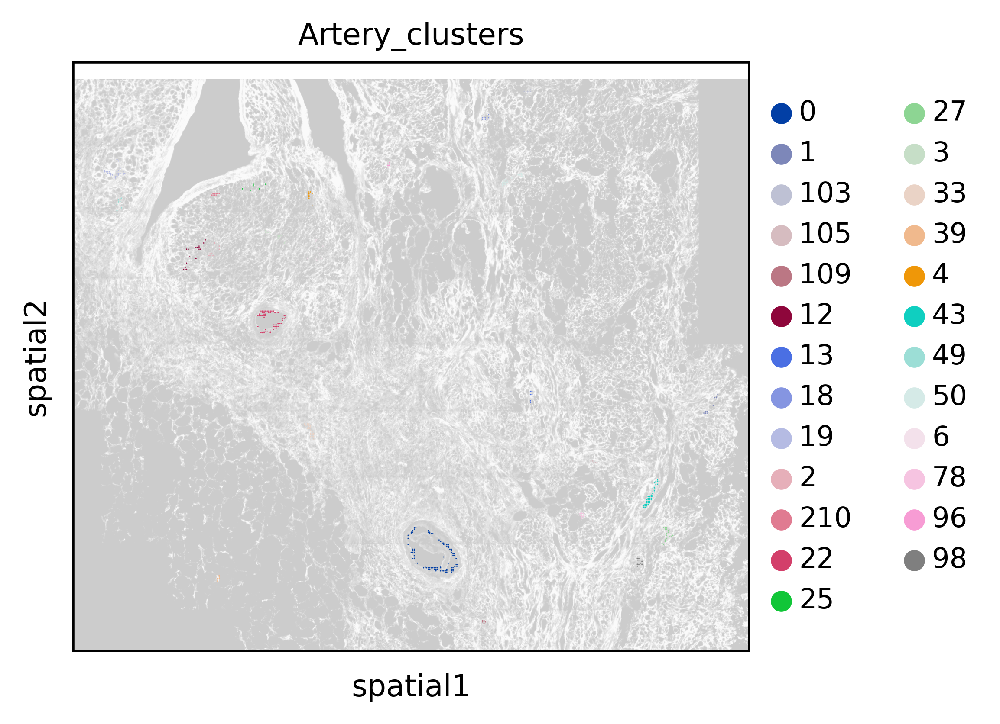

In [149]:
sc.pl.spatial(adata_aec_subset,color="Artery_clusters",img_key='WGA',size=8, alpha_img = 0.2)

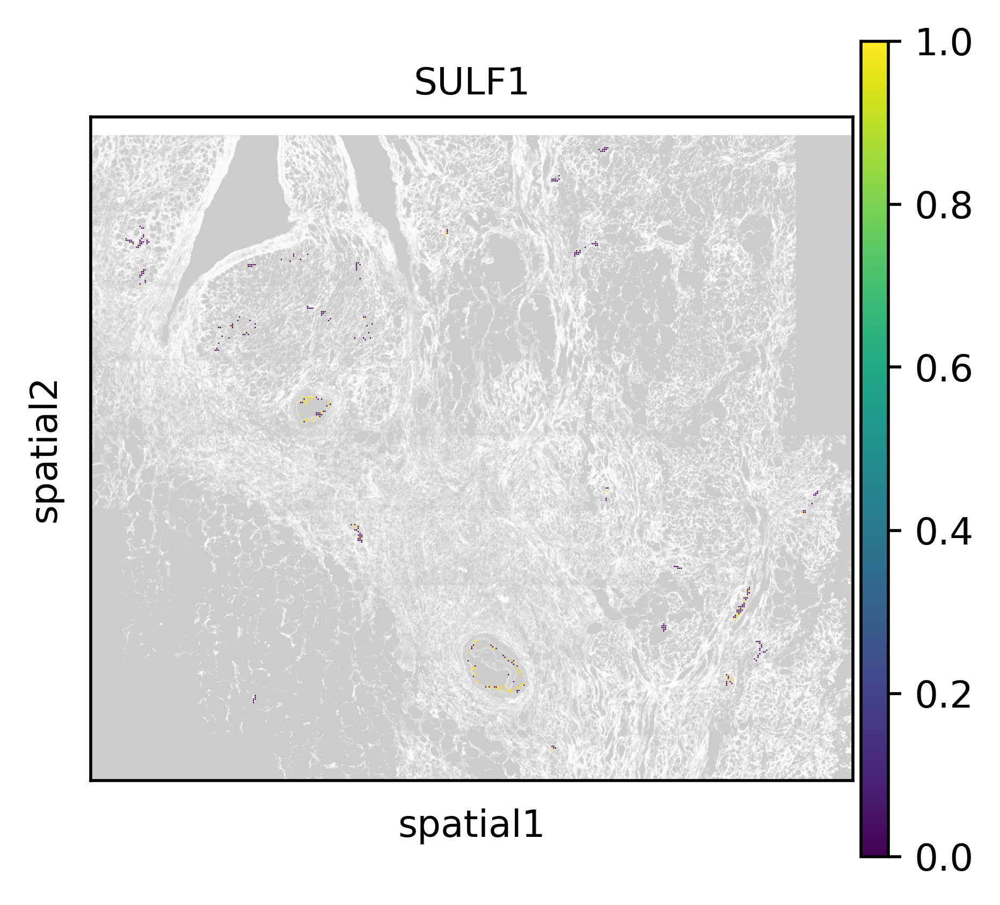

In [150]:
sc.pl.spatial(adata_aec_subset,color="SULF1",img_key='WGA',size=8, alpha_img = 0.2, vmax = 1)

In [151]:
group=pd.Series("Large", index=results2.index)

In [152]:
group[results2["size"] <= 30] = "Small"

In [153]:
group

ROI_D2-1_0      Large
ROI_D2-1_1      Small
ROI_D2-1_103    Small
ROI_D2-1_105    Small
ROI_D2-1_109    Small
ROI_D2-1_12     Small
ROI_D2-1_13     Small
ROI_D2-1_18     Small
ROI_D2-1_19     Small
ROI_D2-1_2      Small
ROI_D2-1_210    Small
ROI_D2-1_22     Large
ROI_D2-1_25     Small
ROI_D2-1_27     Small
ROI_D2-1_3      Small
ROI_D2-1_33     Small
ROI_D2-1_39     Small
ROI_D2-1_4      Small
ROI_D2-1_43     Large
ROI_D2-1_49     Small
ROI_D2-1_50     Small
ROI_D2-1_6      Small
ROI_D2-1_78     Small
ROI_D2-1_96     Small
ROI_D2-1_98     Small
dtype: object

In [154]:
results2["group"] = group

In [155]:
results2

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SULF1,NEBL,SEMA3G,RGCC,size,ROI,group
ROI_D2-1_0,0.0,0.561798,0.000000,3.285714,NaN,1.000000,1.000000,89,D2-1,Large
ROI_D2-1_1,0.0,0.000000,0.000000,1.000000,NaN,NaN,1.600000,11,D2-1,Small
ROI_D2-1_103,0.0,0.000000,0.000000,NaN,NaN,1.250000,NaN,10,D2-1,Small
ROI_D2-1_105,0.0,0.000000,0.000000,NaN,1.000000,2.000000,1.500000,6,D2-1,Small
ROI_D2-1_109,0.0,0.000000,0.000000,1.000000,NaN,1.333333,1.000000,6,D2-1,Small
ROI_D2-1_12,0.0,0.058824,0.176471,1.500000,1.666667,1.000000,4.285714,17,D2-1,Small
ROI_D2-1_13,0.0,0.000000,0.000000,1.000000,1.000000,1.500000,1.666667,6,D2-1,Small
ROI_D2-1_18,0.0,0.000000,0.000000,NaN,1.000000,1.333333,1.000000,9,D2-1,Small
ROI_D2-1_19,0.0,0.000000,0.033333,1.000000,1.500000,1.500000,3.750000,30,D2-1,Small
ROI_D2-1_2,0.0,0.000000,0.000000,1.000000,1.000000,NaN,4.000000,8,D2-1,Small


In [156]:
results4 = results2.drop(["ROI_D2-1_1","ROI_D2-1_2","ROI_D2-1_6","ROI_D2-1_12","ROI_D2-1_25","ROI_D2-1_13"])

In [157]:
results4

,SULF1+NEBL_percent,SULF1_percent,NEBL_percent,SULF1,NEBL,SEMA3G,RGCC,size,ROI,group
ROI_D2-1_0,0.0,0.561798,0.000000,3.285714,NaN,1.000000,1.000000,89,D2-1,Large
ROI_D2-1_103,0.0,0.000000,0.000000,NaN,NaN,1.250000,NaN,10,D2-1,Small
ROI_D2-1_105,0.0,0.000000,0.000000,NaN,1.000000,2.000000,1.500000,6,D2-1,Small
ROI_D2-1_109,0.0,0.000000,0.000000,1.000000,NaN,1.333333,1.000000,6,D2-1,Small
ROI_D2-1_18,0.0,0.000000,0.000000,NaN,1.000000,1.333333,1.000000,9,D2-1,Small
ROI_D2-1_19,0.0,0.000000,0.033333,1.000000,1.500000,1.500000,3.750000,30,D2-1,Small
ROI_D2-1_210,0.0,0.000000,0.000000,1.000000,1.000000,1.166667,4.428571,9,D2-1,Small
ROI_D2-1_22,0.0,0.454545,0.000000,3.000000,NaN,1.000000,NaN,55,D2-1,Large
ROI_D2-1_27,0.0,0.000000,0.117647,1.000000,1.500000,1.600000,2.000000,17,D2-1,Small
ROI_D2-1_3,0.0,0.000000,0.076923,NaN,1.500000,1.000000,4.250000,13,D2-1,Small


In [158]:
results4.to_csv("/rds/general/user/snb20/home/2_Organotypic_EC_Heterogeneity/Sanger_Datasets/Resolve/Arterial_quantification/D2-1.csv")

[Text(0.5, 1.0, 'SULF1 mean expression')]

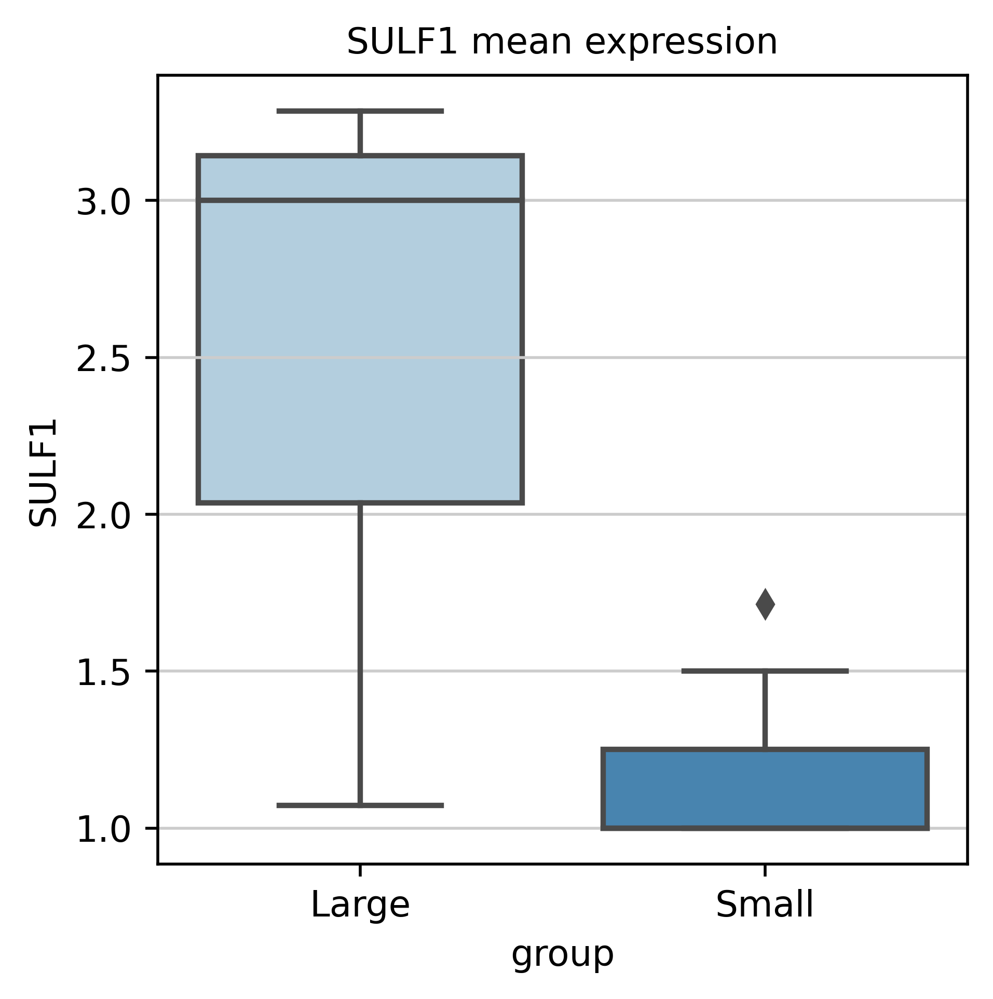

In [159]:
sns.boxplot(data = results2, x = "group", y = "SULF1", palette = 'Blues', order = ['Large','Small']).set(title='SULF1 mean expression')

[Text(0.5, 1.0, 'SULF1 percent expressing')]

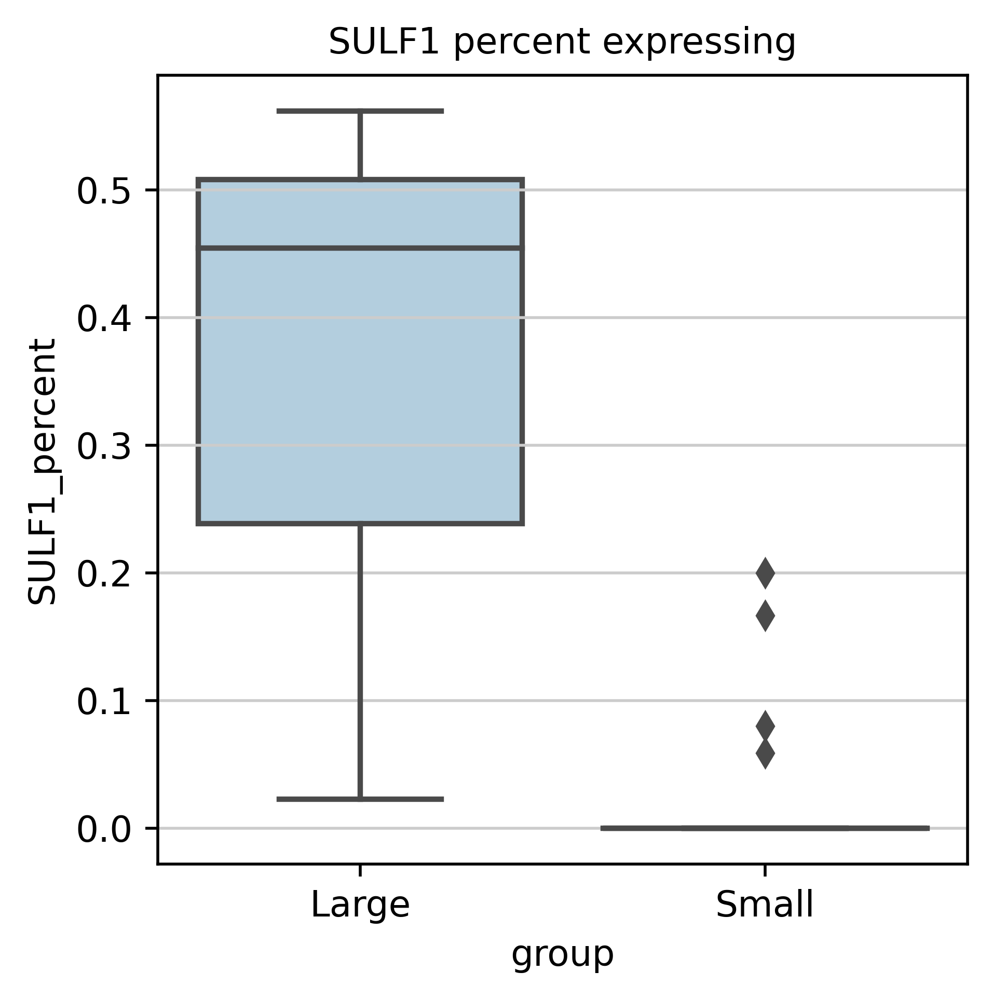

In [160]:
sns.boxplot(data = results2, x = "group", y = "SULF1_percent", palette = 'Blues', order = ['Large','Small']).set(title='SULF1 percent expressing')

[Text(0.5, 1.0, 'RGCC mean expression')]

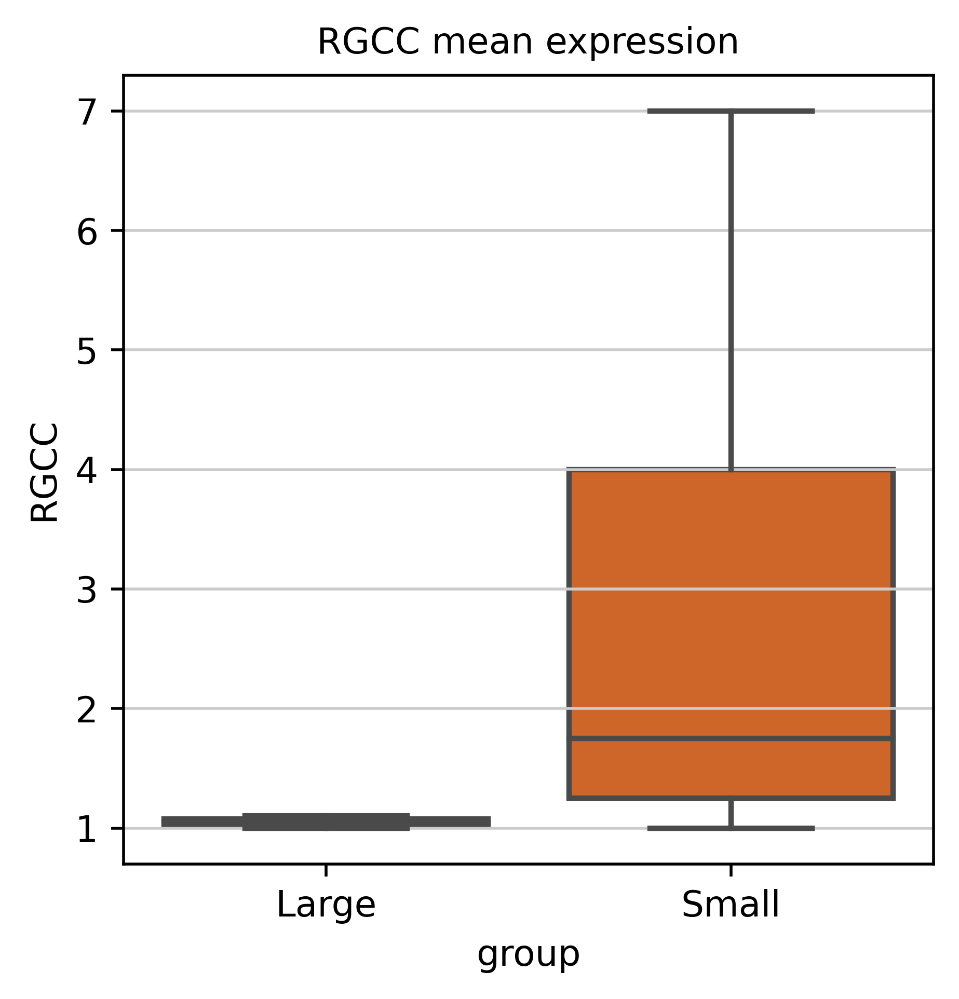

In [161]:
sns.boxplot(data = results2, x = "group", y = "RGCC", palette = 'Oranges', order = ['Large','Small']).set(title='RGCC mean expression')

[Text(0.5, 1.0, 'SEMA3G mean expression')]

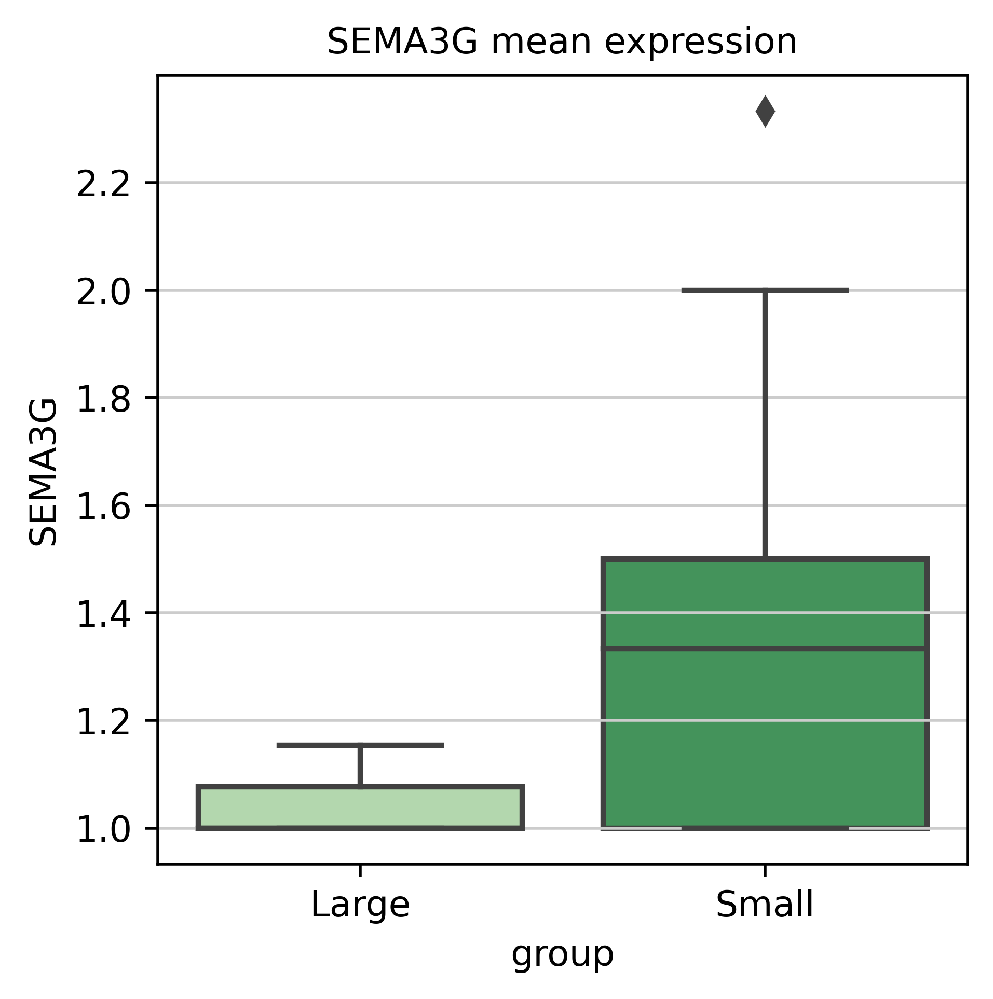

In [162]:
sns.boxplot(data = results2, x = "group", y = "SEMA3G", palette = 'Greens', order = ['Large','Small']).set(title='SEMA3G mean expression')

[Text(0.5, 1.0, 'NEBL mean expression')]

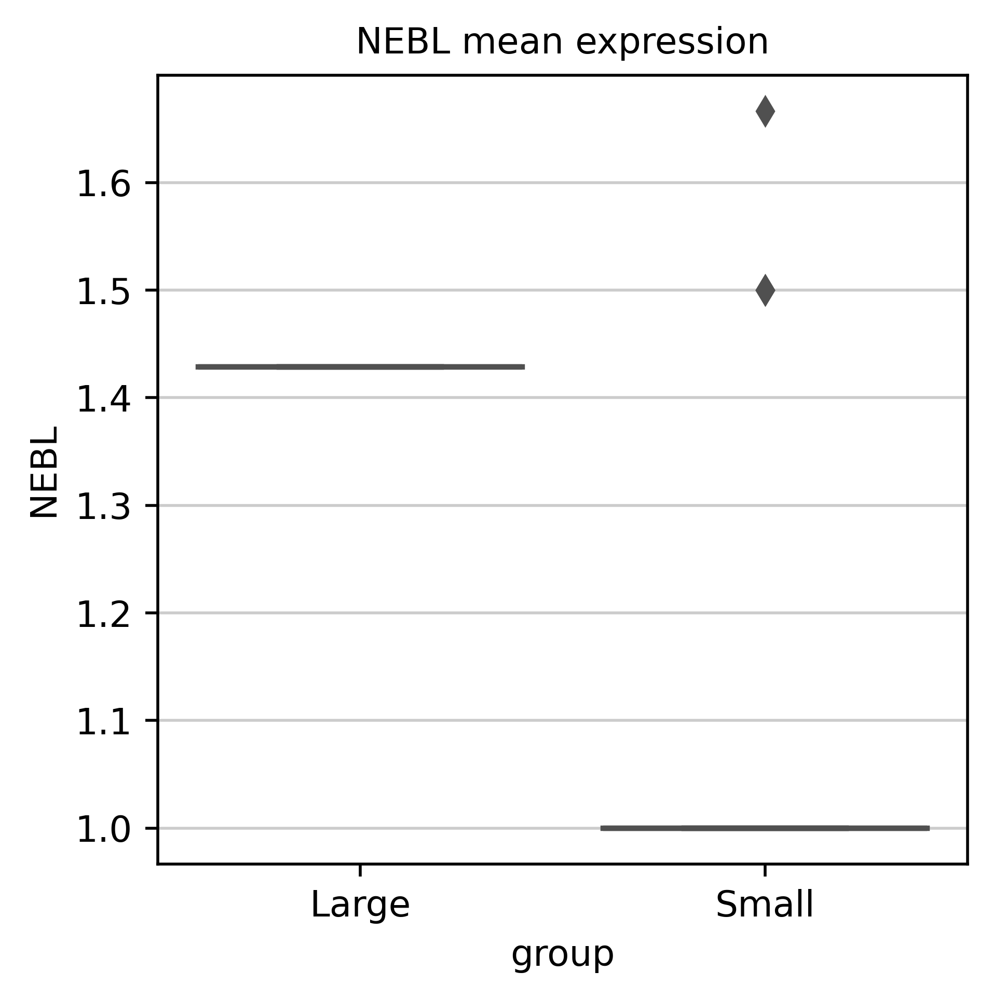

In [163]:
sns.boxplot(data = results2, x = "group", y = "NEBL", palette = 'Reds', order = ['Large','Small']).set(title='NEBL mean expression')

[Text(0.5, 1.0, 'NEBL percent expressing')]

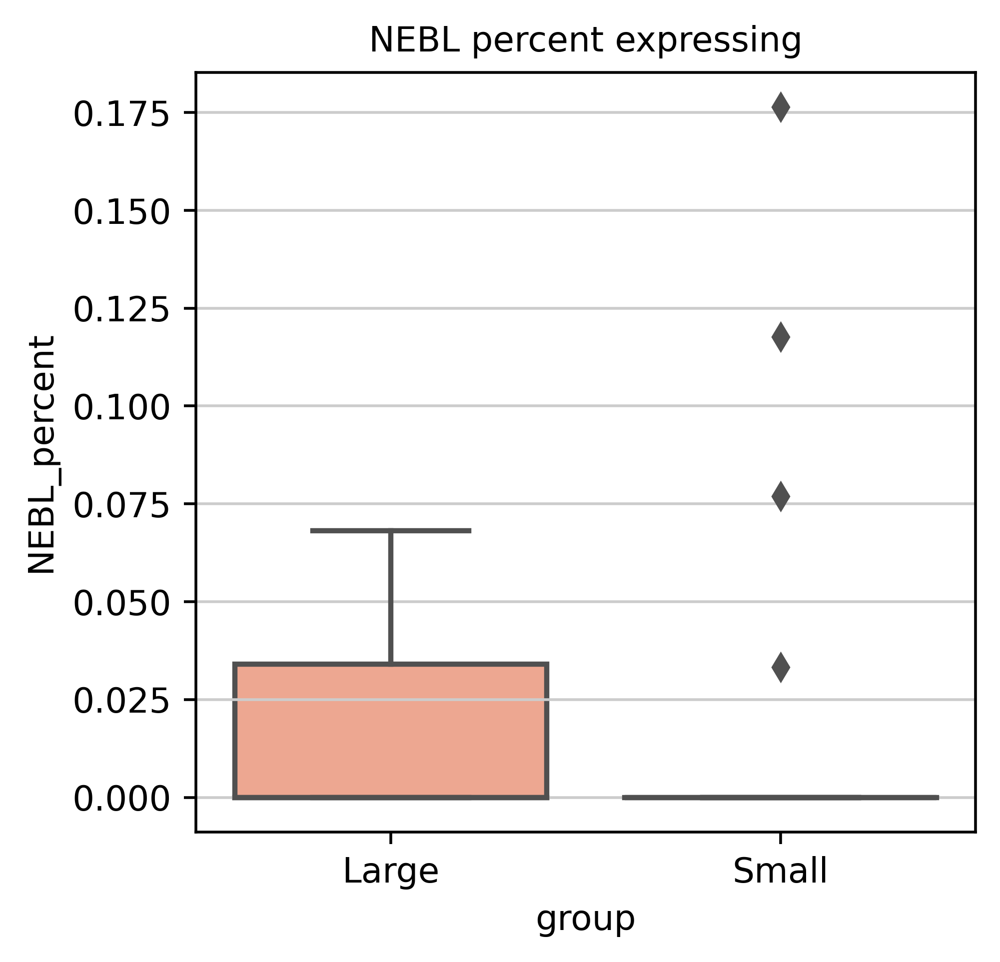

In [164]:
sns.boxplot(data = results2, x = "group", y = "NEBL_percent", palette = 'Reds', order = ['Large','Small']).set(title='NEBL percent expressing')

[Text(0.5, 1.0, 'SULF1+NEBL percent expressing')]

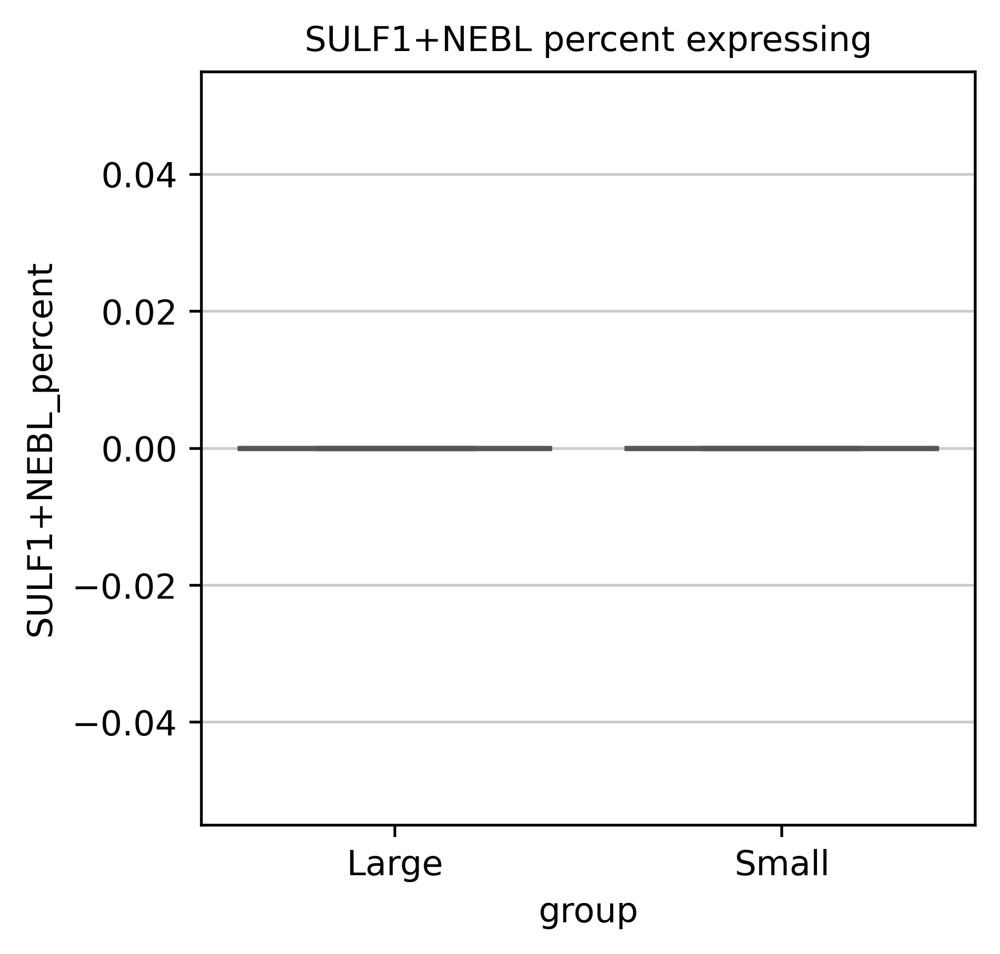

In [165]:
sns.boxplot(data = results2, x = "group", y = "SULF1+NEBL_percent", palette = 'Purples', order = ['Large','Small']).set(title='SULF1+NEBL percent expressing')

In [ ]:
### calculate mean / group

In [ ]:
results3 = results2.groupby("group").mean()

In [ ]:
results3["ROI"] = 'd2-1'

In [ ]:
results3

In [ ]:
markers = ["VWF","GJA5","SEMA3G","SULF1","NEBL","RGCC"]
sc.pl.dotplot(adata_aec_subset, markers, "Artery_clusters", mean_only_expressed = True)
#sc.pl.dotplot(adata_aec_subset, markers, "Artery_clusters", mean_only_expressed = False)

In [ ]:
sc.pl.spatial(adata_aec_subset,color="Artery_clusters",img_key='WGA',size=8, alpha_img = 0.2)